### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?

In [3]:
import pandas as pd
import numpy as np

df = pd.read_csv("../data/USA_Housing.csv")
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\r\nLaurabury, NE 37..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\r\nLake Kathleen, ..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\r\nDanieltown, WI 064..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\r\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\r\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\r\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\r\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\r\nJoshualand, VA ..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\r\nFPO AE 73316


Avg. Area Income
Degree 2
Score: 0.40978359512172113


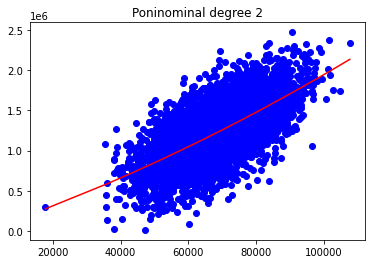

Avg. Area Income
Degree 3
Score: 0.4097925125569428


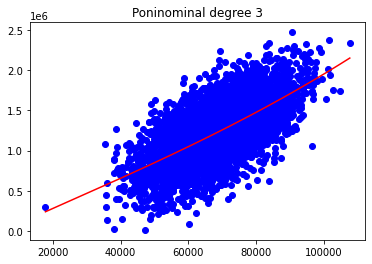

Avg. Area Income
Degree 4
Score: 0.4098386128702074


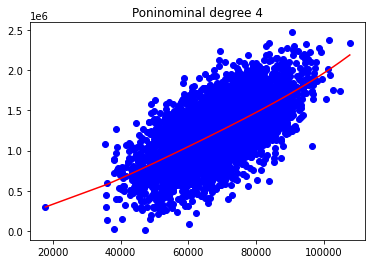

Avg. Area Income
Degree 5
Score: 0.4098457844786829


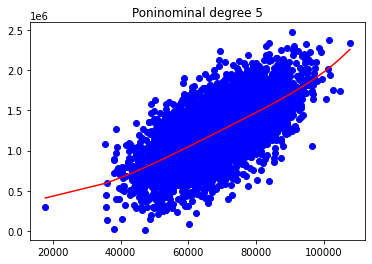

Avg. Area Income
Degree 6
Score: 0.40961767558007456


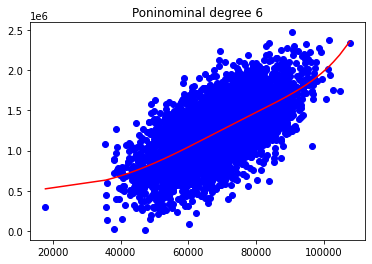

Avg. Area Income
Degree 7
Score: 0.4088326496358783


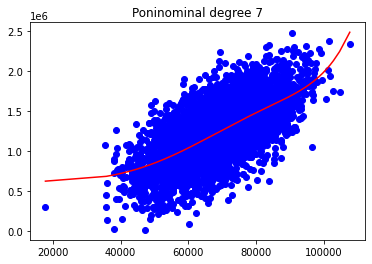

Avg. Area Income
Degree 8
Score: 0.4070925143115033


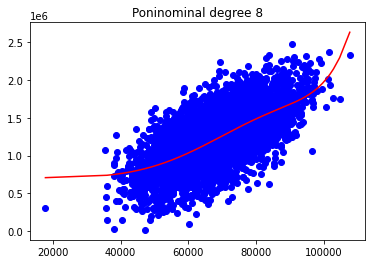

Avg. Area Income
Degree 9
Score: 0.404022199707445


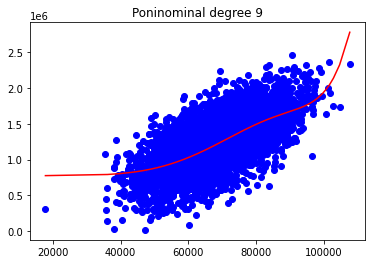

Avg. Area Income
Degree 10
Score: 0.39934777577672687


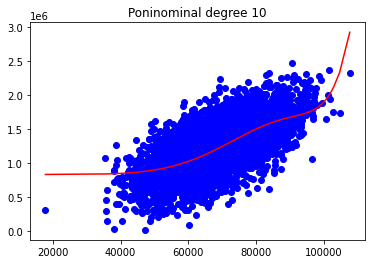

Avg. Area House Age
Degree 2
Score: 0.20480577122135013


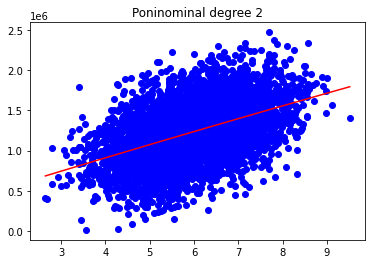

Avg. Area House Age
Degree 3
Score: 0.2050573012492518


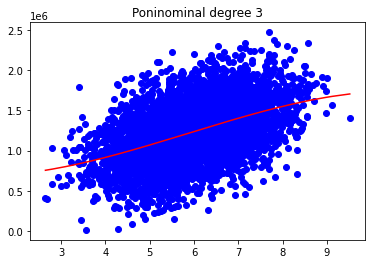

Avg. Area House Age
Degree 4
Score: 0.2050759710444655


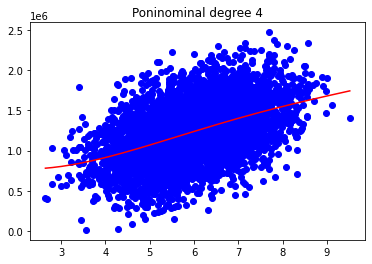

Avg. Area House Age
Degree 5
Score: 0.20546679684881475


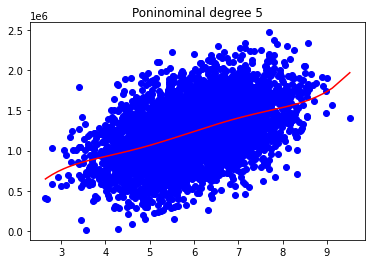

Avg. Area House Age
Degree 6
Score: 0.20619386925295047


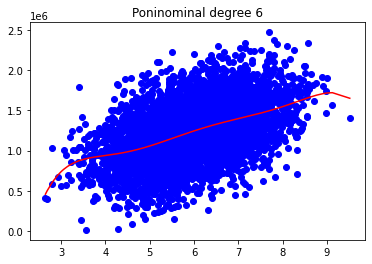

Avg. Area House Age
Degree 7
Score: 0.2069703715159089


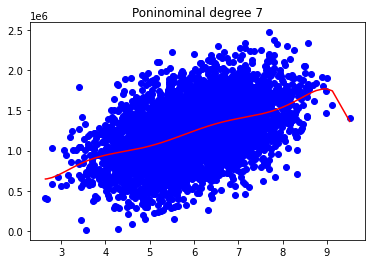

Avg. Area House Age
Degree 8
Score: 0.20706742175959758


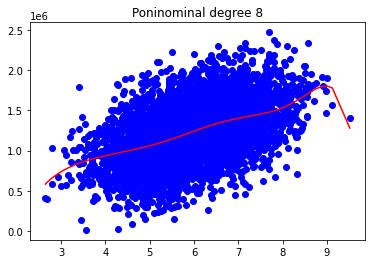

Avg. Area House Age
Degree 9
Score: 0.20793386927794022


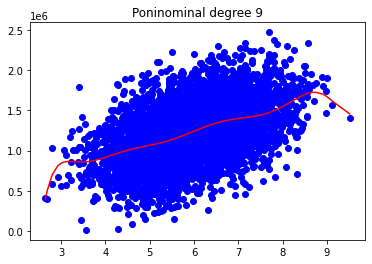

Avg. Area House Age
Degree 10
Score: 0.20816472400910002


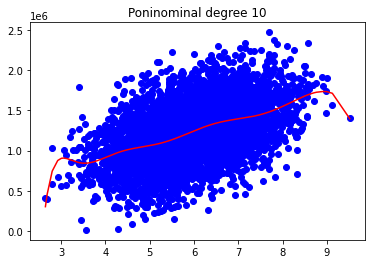

Avg. Area Number of Rooms
Degree 2
Score: 0.11304849965917951


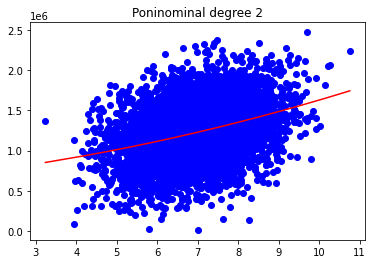

Avg. Area Number of Rooms
Degree 3
Score: 0.11339935715410365


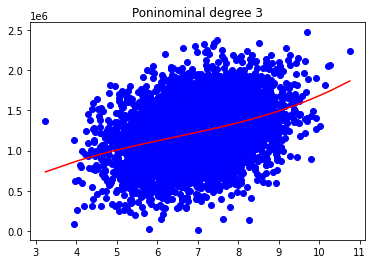

Avg. Area Number of Rooms
Degree 4
Score: 0.11384129190896031


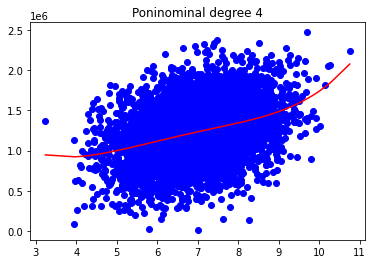

Avg. Area Number of Rooms
Degree 5
Score: 0.11384507978750313


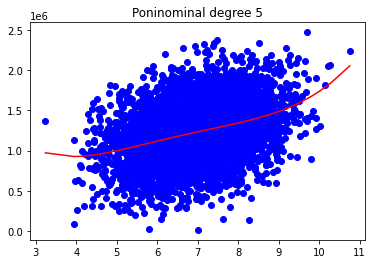

Avg. Area Number of Rooms
Degree 6
Score: 0.11393463075566579


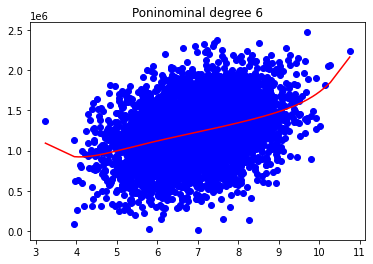

Avg. Area Number of Rooms
Degree 7
Score: 0.11394183461067131


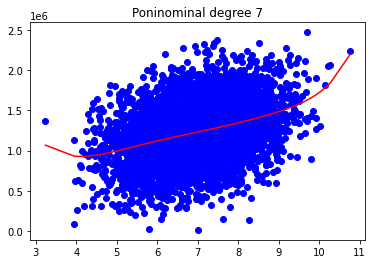

Avg. Area Number of Rooms
Degree 8
Score: 0.11465200010383336


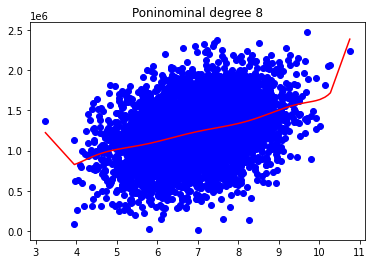

Avg. Area Number of Rooms
Degree 9
Score: 0.11554404451731615


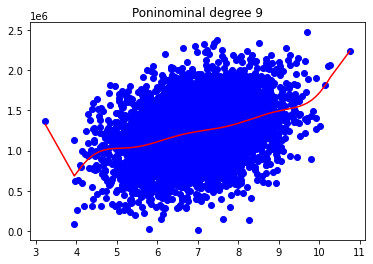

Avg. Area Number of Rooms
Degree 10
Score: 0.11571105584441976


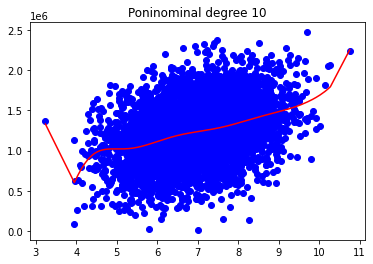

Avg. Area Number of Bedrooms
Degree 2
Score: 0.029323262230417924


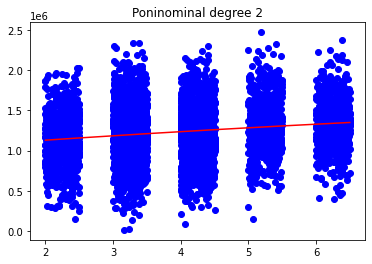

Avg. Area Number of Bedrooms
Degree 3
Score: 0.029395193523975682


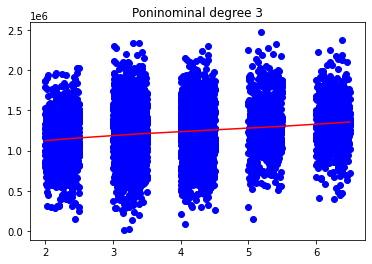

Avg. Area Number of Bedrooms
Degree 4
Score: 0.03352014963609218


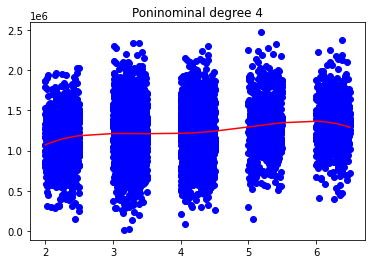

Avg. Area Number of Bedrooms
Degree 5
Score: 0.03387683200198777


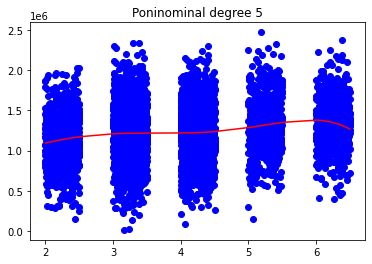

Avg. Area Number of Bedrooms
Degree 6
Score: 0.03557011049243064


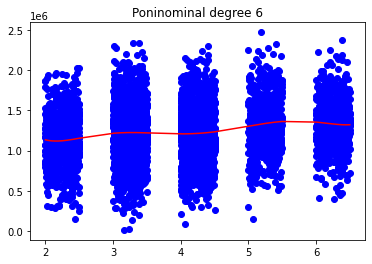

Avg. Area Number of Bedrooms
Degree 7
Score: 0.03557109202410025


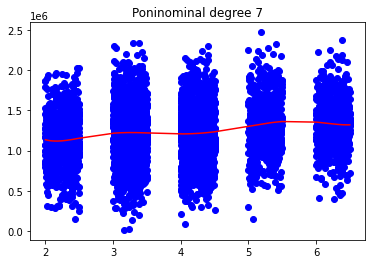

Avg. Area Number of Bedrooms
Degree 8
Score: 0.03558461650285394


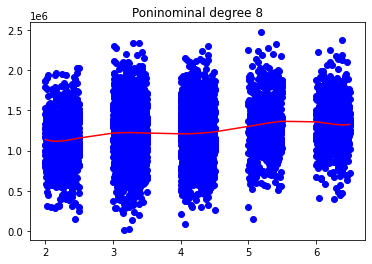

Avg. Area Number of Bedrooms
Degree 9
Score: 0.03565440309953938


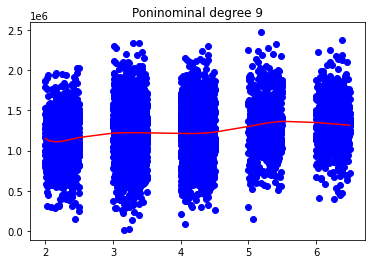

Avg. Area Number of Bedrooms
Degree 10
Score: 0.03578733574905302


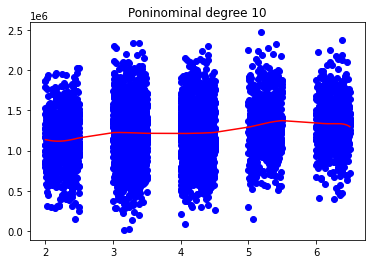

Area Population
Degree 2
Score: 0.1669618276820598


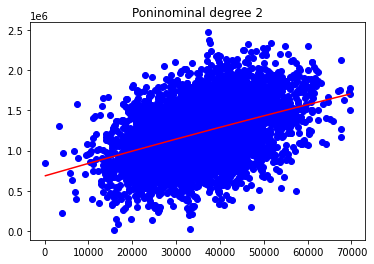

Area Population
Degree 3
Score: 0.1670244568257938


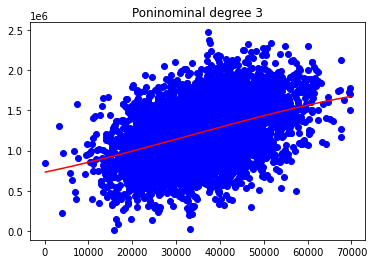

Area Population
Degree 4
Score: 0.16699391321922685


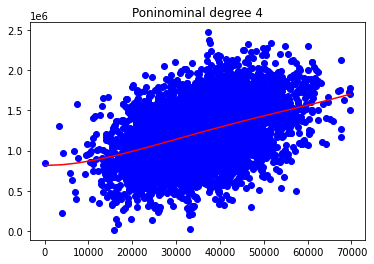

Area Population
Degree 5
Score: 0.1663380337296757


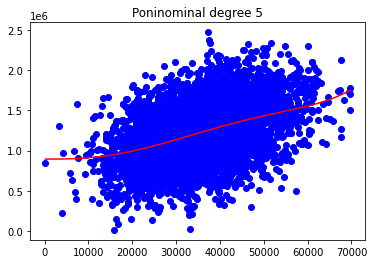

Area Population
Degree 6
Score: 0.16454199224784927


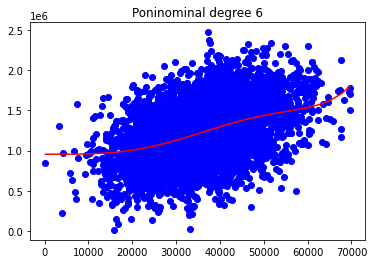

Area Population
Degree 7
Score: 0.1613211695088541


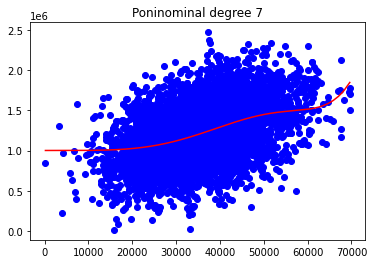

Area Population
Degree 8
Score: 0.15662658080433034


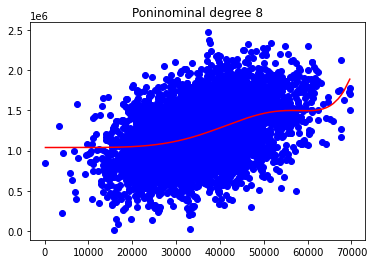

Area Population
Degree 9
Score: 0.1505962211783265


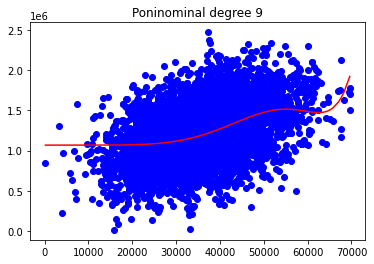

Area Population
Degree 10
Score: 0.1434744279658522


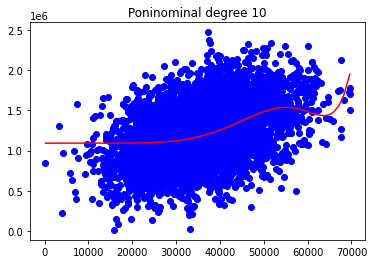

In [21]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import r2_score, mean_absolute_error
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
import seaborn as sn
import matplotlib.pyplot as plt


y = np.array(df['Price'])
lista_col = ['Avg. Area Income','Avg. Area House Age','Avg. Area Number of Rooms','Avg. Area Number of Bedrooms','Area Population']
results = {}
for elem in lista_col:
    X = np.array(df[elem]).reshape(-1,1)
    results[elem]= {}
    for i in range(2,11):
        polinominal_model = PolynomialFeatures(i) 
        # para cada variable tendrá tantos coeficientes como grados, es un paso necesario antes de entrenar el modelo de regresión con el fit
        X_poly = polinominal_model.fit_transform(X, y)
        
        # Llamar a la regresión lineal entrenándola con la salida del fit_transform
        lin_reg_model = LinearRegression()
        lin_reg_model.fit(X_poly, y) 
        y_pred = lin_reg_model.predict(X_poly)

        print(elem)
        print("Degree", i)
        print("Score:", r2_score(y, y_pred))
        results[elem][i] = r2_score(y, y_pred)

        X_train_to_show, y_train_to_show = zip(*sorted(zip(X, y))) # ordenación 'sorted' de los elementos 

        plt.scatter(X_train_to_show, y_train_to_show, color='b')
        X_train_to_show, y_pred = zip(*sorted(zip(X, y_pred)))
        plt.plot(X_train_to_show, y_pred, color='red')
        #plt.scatter(X_train_to_show, y_pred, color='red')
        plt.title("Poninominal degree " + str(i))
        plt.show()

In [19]:
print(results)

{'Avg. Area Income': {2: 0.40978359512172113, 3: 0.4097925125569428, 4: 0.4098386128702074, 5: 0.4098457844786829, 6: 0.40961767558007456, 7: 0.4088326496358783, 8: 0.4070925143115033, 9: 0.404022199707445, 10: 0.39934777577672687}, 'Avg. Area House Age': {2: 0.20480577122135013, 3: 0.2050573012492518, 4: 0.2050759710444655, 5: 0.20546679684881475, 6: 0.20619386925295047, 7: 0.2069703715159089, 8: 0.20706742175959758, 9: 0.20793386927794022, 10: 0.20816472400910002}, 'Avg. Area Number of Rooms': {2: 0.11304849965917951, 3: 0.11339935715410365, 4: 0.11384129190896031, 5: 0.11384507978750313, 6: 0.11393463075566579, 7: 0.11394183461067131, 8: 0.11465200010383336, 9: 0.11554404451731615, 10: 0.11571105584441976}, 'Avg. Area Number of Bedrooms': {2: 0.029323262230417924, 3: 0.029395193523975682, 4: 0.03352014963609218, 5: 0.03387683200198777, 6: 0.03557011049243064, 7: 0.03557109202410025, 8: 0.03558461650285394, 9: 0.03565440309953938, 10: 0.03578733574905302}, 'Area Population': {2: 0.16

Resultados:

-'Avg. Area Income': las mejoras del score son ínfimas; cabe destacar que a partir del grado 5 la mejora del score desciende y que para el grado 10 desciende mucho.

-'Avg. Area House Age': las mejoras del score son ínfimas con cada aumento de grado (del orden de 1% de mejora)

-'Avg. Area Number of Rooms': ídem

-'Avg. Area Number of Bedrooms': ídem, cabe destacar que el score nunca es mejor que el 5%

-'Area Population': las variaciones del score son ínfimas, y a partir del 3 grado el score deja de mejorar para ser cada vez peor.